Felipe Bartelt de Assis Pessoa - 2016026841

#  Superfícies separadoras geradas por ELM's

Para a visualização das superfícies separadoras geradas por redes neurais do tipo ELM, será feito um estudo de caso baseado em alguns *datasets* famosos para treinamento de dados: 2D-Normals, XOR, Circles e Spirals. Para todos esses, tormar-se-á a variação do número de neurônios da camada intermediária $p$ por $p = [5, 10, 20, 30, 40, 50]$, visando a tentativa de visualização de *underfitting*, *overfitting* e uma aproximação razoável para cada conjunto de dados.

O primeiro *dataset* utilizado foi o 2D-Normals, que pode ser gerado, em Python, por meio da função `make_blobs` da biblioteca `sklearn`. Tomou-se 200 exemplos de treino no total. Os dados gerados podem ser visualizados da seguinte forma:

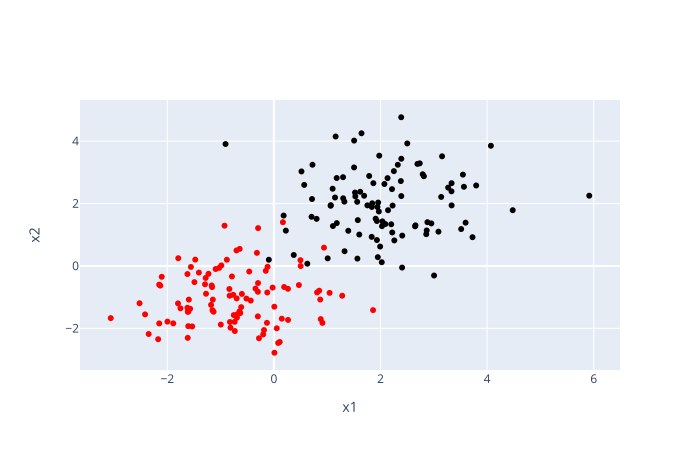

In [80]:
import numpy as np
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from sklearn import datasets

X, Y = datasets.make_blobs(200, centers = [[2,2],[-1,-1]])

red_sample = go.Scatter(x=X[Y==1,0], y=X[Y==1,1], mode = 'markers', marker_color = 'red', showlegend = False)
black_sample = go.Scatter(x=X[Y==0,0], y=X[Y==0,1], mode = 'markers', marker_color = 'black', showlegend = False)
fig = go.Figure(red_sample)
fig.update_layout(xaxis={'title':'x1'}, yaxis={'title':'x2'})
fig.add_trace(black_sample)
fig.show(renderer = 'svg')


Em seguida, definiu-se a função `train_elm` que treina uma rede neural do tipo ELM com base na função de ativação sigmoidal $\tanh(\cdot)$, que recebe como parâmetros os dados de treino `x_train, y_train` e o número de neurônios da camada intermediária `hidden_dim`, a função retorna o vetor de pesos $W$ obtido e a matriz $Z$ de pesos aleatórios.

Também foi criada a função `make_grid` que executa a ação de treinar, para o mesmo conjunto de dados, diversas redes neurais ELM com número de neurônios diferentes, dado pelo parâmetro `dim_list`. Essa função ainda retorna a figura com os gráficos e contornos obtidos para cada número de neurônios $p$, além de todos os dados necessários para se plotar uma superfície externamente. As figuras geradas tem regiões avermelhadas, que representam a classificação da amostra como bolinhas vermelhas, e regiões azuladas, que representam a classificação como bolinhas pretas.

In [55]:
def train_elm(x_train, y_train, hidden_dim):
    # returns a weight vector based on sigmoidal mapping given by tanh
    m = np.shape(x_train)[1]
    Z = np.random.default_rng().uniform(-0.5, 0.5, (m, hidden_dim))
    H = np.tanh(x_train @ Z)
    W = np.linalg.pinv(H) @ y_train 
    
    return W, Z

def make_grid(X, Y, dim_list, title):
    margin = 0.25
    mesh_size = 0.02
    x_min, x_max = X[:, 0].min() - margin, X[:, 0].max() + margin
    y_min, y_max = X[:, 1].min() - margin, X[:, 1].max() + margin
    x_range = np.arange(x_min, x_max, 0.02)
    y_range = np.arange(y_min, y_max, 0.02)
    xx, yy = np.meshgrid(x_range, y_range)
    zz = np.c_[xx.ravel(), yy.ravel()]
    N = np.shape(X)[0]
    x_train = np.append(np.ones((N,1)), X, axis=1)

    fig =  make_subplots(rows=3, cols=2, subplot_titles= tuple('p='+str(i) for i in dim_list))
    fig.update_layout(autosize = False, width = 800, height = 800, 
                       margin=dict(l = 80, r = 80, t = 80, b = 80), 
                       title = dict(text = title, x = 0.5, y = 0.95), xaxis_title  ='test')
    fig.update_xaxes(range=[x_min, x_max])
    fig.update_yaxes(range=[y_min, y_max])
    for i in range(1,7): 
        fig['layout']['xaxis{}'.format(i)]['title']='x1'
        fig['layout']['yaxis{}'.format(i)]['title']='x2'
        fig['layout']['yaxis{}'.format(i)]['title_standoff'] = 2

    surf_list = []
    for i, p in enumerate(dim_list):
        w, Z = train_elm(x_train, Y, p)
        x_t = np.append(np.ones((np.shape(zz)[0],1)), zz, axis = 1)
        z = np.tanh(x_t @ Z) @ w
        z = np.sign(z.reshape(xx.shape))
        region = go.Contour(x= x_range, y= y_range, z=z, colorscale='RdBu', opacity=0.4,
                            showscale=False, reversescale = True)
        fig.add_trace(region, row = int(np.ceil((i+1)/2)), col = 2**(i%2))
        fig.add_trace(black_sample, row = int(np.ceil((i+1)/2)), col = 2**(i%2))
        fig.add_trace(red_sample, row = int(np.ceil((i+1)/2)), col = 2**(i%2))
        surf_list.append((x_range, y_range, z))

    return fig, surf_list


Uma vez que a função de ativação é a tangente hiperbólica, deve-se alterar o vetor de saída $Y$ para, ao invés de binários, valores $-1$ ou $1$. Com isso feito, plota-se as diferentes superfícies para o conjunto de dados:

In [82]:
Y[Y==0] = -1
Y = np.reshape(Y, (-1,1)) 

dim_list = [5, 10, 20, 30, 40, 50]
fig2, surf_list = make_grid(X, Y, dim_list, '2D-Normals')
fig2.show(renderer = 'svg', width = 800, height = 700)



Por meio da visualização das superfícies, pode-se notar que a aproximação com número de neurônios $p=10$ aparenta ser a melhor, uma vez que com 20 neurônios já se começa a visualizar um *overfitting*. A proximação com 5 neurônios apesar de aparentar boa, não parece uma aproximação "natural", sendo então necessário realizar um estudo de validação cruzada para encontrar o melhor número de neurônios no intervalo $[5,20)$.

Tomou-se como interessante a visualização da superfície gerada pela rede neural treinada para o número de neurônios suposto como melhor. Dessa forma, segue a seguir a superfície dada por $p=10$:

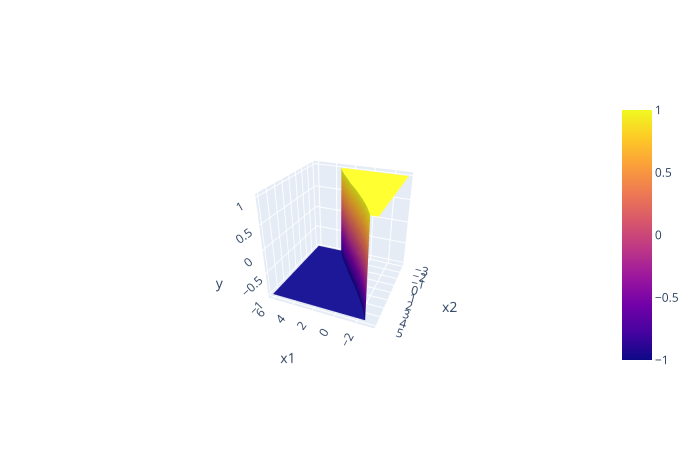

In [96]:
fig3 = go.Figure(go.Surface(x = surf_list[1][0], y = surf_list[1][1], z= surf_list[1][2]))
fig3.update_scenes(camera = dict(eye={'x':-1, 'y':2.4, 'z':1.4}), xaxis_title = {'text':'x1'}, yaxis_title = {'text':'x2'}, zaxis_title = {'text':'y'})
fig3.show(renderer = 'svg')


O próximo conjunto de dados a ser estudado é o conjunto XOR, que não existe na biblioteca citada, assim, criou-se um vetor $X$ bidimensional de distribuição normal, com $100$ amostras. Para a resposta $Y$, tomou-se a resposta de um comando XOR sobre a operação booleana das colunas do vetor $X$ serem maiores que $0$. Os dados gerados são:

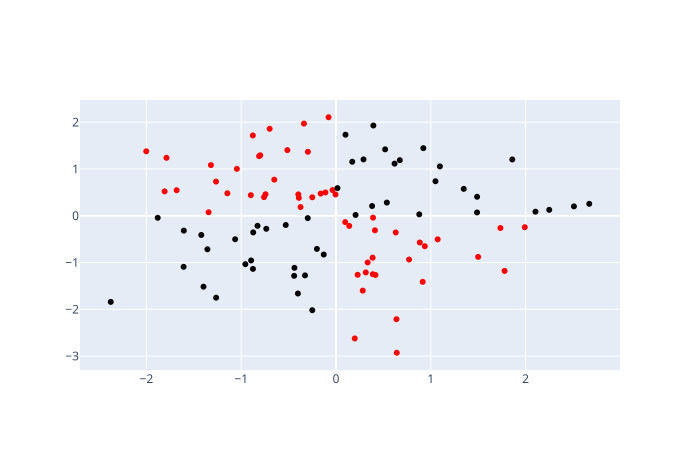

In [98]:
X = np.random.default_rng().standard_normal((100, 2))
Y = np.logical_xor(X[:, 0] > 0, X[:, 1] > 0).astype(int)
Y[Y==0] = -1

red_sample = go.Scatter(x=X[Y==1, 0], y=X[Y==1,1], mode = 'markers', marker_color = 'red', showlegend = False)
black_sample = go.Scatter(x=X[Y==-1,0], y=X[Y==-1,1], mode = 'markers', marker_color = 'black', showlegend = False)
fig3 = go.Figure(red_sample)
fig3.add_trace(black_sample)
fig3.show(renderer = 'svg')


Novamente, troca-se os valores nulos de $Y$ para valores iguais a $-1$ e aplica-se a função `make_grid`, os resultados para o conjunto são mostrados a seguir:

In [99]:
Y = np.reshape(Y, (-1,1)) 

dim_list = [5, 10, 20, 30, 40, 50]
fig4, surf_list = make_grid(X, Y, dim_list, 'XOR')

fig4.show(renderer = 'svg', width = 800, height = 700)


Dentre as aproximações mostradas, é visível que a melhor foi com $p=10$, uma vez que, com mais neurônios, há *overfitting* claro e para $p=5$, tem-se um *underfitting*, classificando várias amostras erroneamente. 

Assim, novamente se plota a superfície gerada por $p=10$:

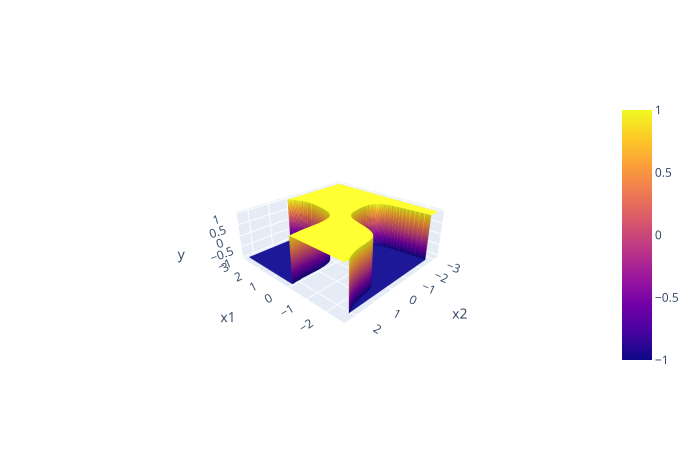

In [103]:
fig5 = go.Figure(go.Surface(x = surf_list[1][0], y = surf_list[1][1], z= surf_list[1][2]))
fig5.update_scenes(camera = dict(eye={'x':-2, 'y':2.1, 'z':1.4}), xaxis_title = {'text':'x1'}, yaxis_title = {'text':'x2'}, zaxis_title = {'text':'y'})
fig5.show(renderer = 'svg')


O conjunto de dados Circles corresponde a dois círculos concêntricos, uma vez que o `sklearn` fornece esse conjunto sem qualquer ruído, tomou-se a liberdade para adicionar um desvio padrão de $0.12$ de forma a tornar o problema menos simples para separação:

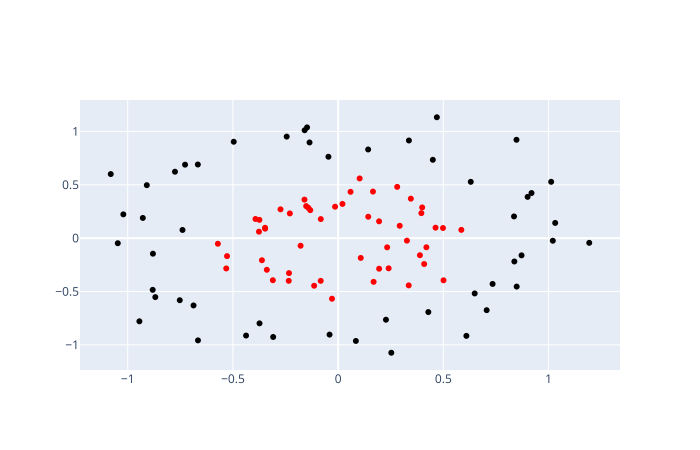

In [109]:
X, Y = datasets.make_circles(noise = 0.12, factor = 0.4)
Y[Y==0] = -1
red_sample = go.Scatter(x=X[Y==1,0], y=X[Y==1,1], mode = 'markers', marker_color = 'red', showlegend = False)
black_sample = go.Scatter(x=X[Y==-1,0], y=X[Y==-1,1], mode = 'markers', marker_color = 'black', showlegend = False)
fig5 = go.Figure(red_sample)
fig5.add_trace(black_sample)
fig5.show(renderer = 'svg')


Modificando-se as saídas nulas para $-1$, pode-se plotar as respostas obtidas:

In [110]:
Y = np.reshape(Y, (-1,1)) 

fig6, surf_list = make_grid(X, Y, dim_list, 'Circles')
fig6.show(renderer = 'svg', width = 800, height = 700)


Novamente, fica claro pelos gráficos, que $p=10$ é o melhor número de neurônios, $p=5$ apresenta *underfitting* e os valores superiores, *overfitting* claro. A superfície obtida para o número de neurônios ótimo, dentre os testados, é a seguinte:

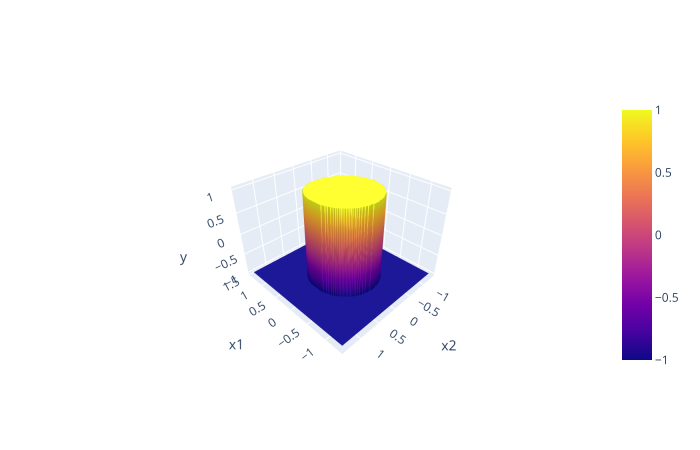

In [114]:
fig7 = go.Figure(go.Surface(x = surf_list[1][0], y = surf_list[1][1], z= surf_list[1][2]))
fig7.update_scenes(camera = dict(eye={'x':-1.5, 'y':1.5, 'z':1.4}), xaxis_title = {'text':'x1'}, yaxis_title = {'text':'x2'}, zaxis_title = {'text':'y'})
fig7.show(renderer = 'svg')


Para o conjunto de dados Spirals, tornou-se necessária sua implementação, dada pela função `twospirals`, uma vez que esse conjunto de dados não existe na biblioteca utilizada.

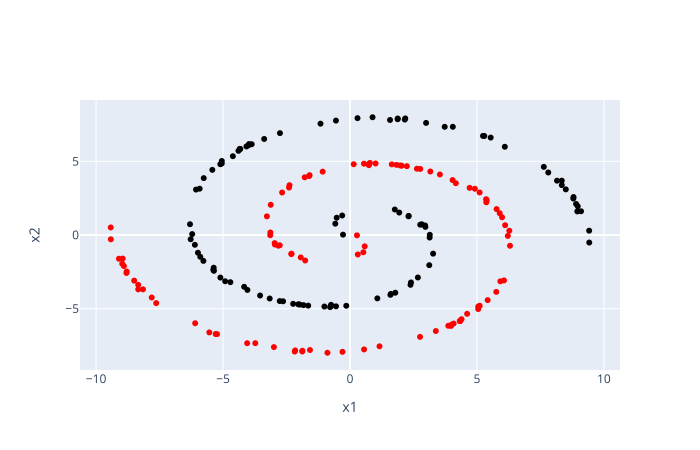

In [117]:
def twospirals(n_points, noise=0.5, factor = 1):
    # Returns the two spirals dataset.
    n = np.sqrt(np.random.rand(n_points,1)) * 780 * factor * (2*np.pi)/360
    d1x = -np.cos(n)*n + np.random.default_rng().standard_normal((n_points,1)) * noise
    d1y = np.sin(n)*n + np.random.default_rng().standard_normal((n_points,1)) * noise
    return (np.vstack((np.hstack((d1x,d1y)),np.hstack((-d1x,-d1y)))), 
            np.hstack((np.zeros(n_points),np.ones(n_points))))


X, Y = twospirals(100, 0.05, 0.7)

Y[Y==0] = -1
red_sample = go.Scatter(x=X[Y==1,0], y=X[Y==1,1], mode = 'markers', marker_color = 'red', showlegend=False)
black_sample = go.Scatter(x=X[Y==-1,0], y=X[Y==-1,1], mode = 'markers', marker_color = 'black', showlegend=False)
fig7 = go.Figure(red_sample)
fig7.update_layout(xaxis={'title':'x1'}, yaxis={'title':'x2'})
fig7.add_trace(black_sample)
fig7.show(renderer = 'svg')


Alterando-se os dados de saída nulos para $-1$, pode-se obter as separações:

In [118]:
Y = np.reshape(Y, (-1,1)) 

fig6, surf_list = make_grid(X, Y, dim_list, 'Spirals')
fig6.show(renderer = 'svg', width = 800, height = 700)


Para esse conjunto de dados, vê-se um comportamento extremamente diferente. O valor de neurônios $10$, ideal para diversos conjuntos anteriores, se mostra ineficaz para separar as duas espirais. Para $p=5$ e $p=10$ há claro *underfitting*, $p=20$ é uma melhora, mas não muito e a partir de $p=30$ a rede neural começa a ser uma melhor aproximação.

É difícil dizer, devido ao formato dos dados, se há *overfitting* para as aproximações obtidas, dessa forma, tomar-se-á como melhor a rede com $p=50$, apesar das redes com $30$ e $40$ neurônios já serem aproximações razoavelmente boas. A superfície formada é a seguinte:

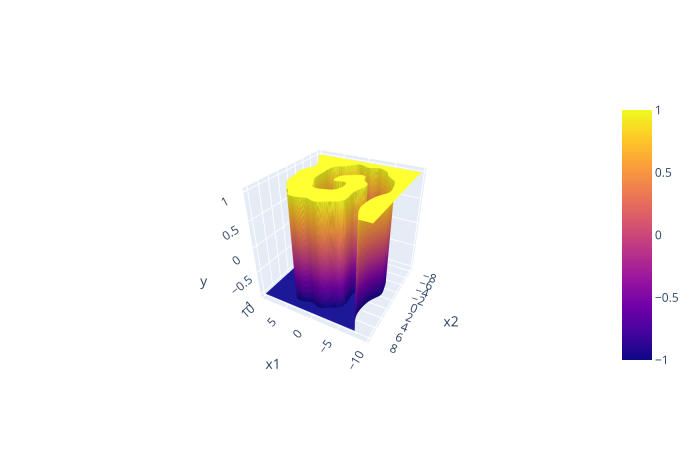

In [122]:
fig6 = go.Figure(go.Surface(x = surf_list[5][0], y = surf_list[5][1], z= surf_list[5][2]))
fig6.update_scenes(camera = dict(eye={'x':-1.1, 'y':2, 'z':1.4}), xaxis_title = {'text':'x1'}, yaxis_title = {'text':'x2'}, zaxis_title = {'text':'y'})
fig6.show(renderer = 'svg')